<a href="https://colab.research.google.com/github/LaughBuddha/Audio-Source-Separation/blob/master/Open_Unmix_Implementation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

__Open-Unmix__ is a deep neural network reference implementation for music source separation.

Open-Unmix is based on a three-layer bidirectional deep LSTM. The model learns to predict the magnitude spectrogram of a target, like vocals, from the magnitude spectrogram of a mixture input. Internally, the prediction is obtained by applying a mask on the input. The model is optimized in the magnitude domain using mean squared error and the actual separation is done in a post-processing step involving a multichannel wiener filter implemented using norbert. To perform separation into multiple sources, multiple models are trained for each particular target. While this makes the training less comfortable, it allows great flexibility to customize the training data for each target source.

![OU_Arch](https://camo.githubusercontent.com/b5a867eb9b7c0a0fa0d8dc90962628ea41a8a374/68747470733a2f2f646f63732e676f6f676c652e636f6d2f64726177696e67732f642f652f32504143582d317654506f516950776d6466455434705a68756531527647376f45554a7a376555655176437536767a59654b5277486c366279345252546e7068496d534b4d306b354b587739725a316949466e7047572f7075623f773d39353926683d333038)

MUSDB18 is the largest freely available dataset for source separation till date. It consists of 150 full-length music tracks (totalling 10 hours) from different genres along with their iso- lated drums, bass, vocals and accompaniment stems [5]. The training set is comprised of 100 tracks, with the remaining 50 tracks constituting the test set. Each instance in the dataset is a 44.1kHz stereo track composed of the full mix plus four stems. The stems are labeled as follows.

```
!pip install musdb
import musdb
```



# **Infrastructure setup**

In [ ]:
%%capture
!pip install gitpython
!pip install musdb
!git clone https://github.com/sigsep/open-unmix-pytorch.git

!apt install -y libsndfile1 ffmpeg
!pip install museval
!pip install -q scikit_posthocs
!pip install librosa

!pip install tqdm
!pip install norbert
!pip install museval

In [ ]:
import scipy.signal
from tqdm import tnrange, tqdm_notebook
import matplotlib.pyplot as plt
from matplotlib import gridspec
import warnings
import random
import sklearn.preprocessing
import norbert
import musdb
import museval
warnings.simplefilter(action='ignore', category=FutureWarning)


import torch
import torch.utils
import torch.utils.data

import numpy as np
import scipy
import librosa
import librosa.display
# import youtube_dl
import os
# import soundfile as sf
from google.colab import files
from IPython.display import Audio, display

use_cuda = torch.cuda.is_available()
device = torch.device("cuda" if use_cuda else "cpu")

# **Download the musdb dataset**

In [ ]:
import musdb
mus = musdb.DB(download=True, subsets="train")

Done!


# **Data Exploration/Visualization**

**Load and play a single audio track**

In [ ]:
track = mus[39]
print(track.name)
display(Audio(track.audio.T, rate=track.rate))

James May - All Souls Moon


In [ ]:
track.path

'/root/MUSDB18/MUSDB18-7/train/James May - All Souls Moon.stem.mp4'

In [ ]:
track.targets

OrderedDict([('vocals', vocals),
             ('drums', drums),
             ('bass', bass),
             ('other', other),
             ('accompaniment', bass+drums+other),
             ('linear_mixture', vocals+bass+drums+other)])

In [ ]:
track.audio.shape

(300032, 2)

In [ ]:
track.audio

array([[-3.41491699e-02, -7.35473633e-03],
       [-4.08020020e-02, -6.50024414e-03],
       [-2.99682617e-02, -1.03759766e-03],
       ...,
       [-6.71386719e-04,  9.15527344e-05],
       [-6.10351562e-04,  1.22070312e-04],
       [-3.66210938e-04,  1.83105469e-04]])

In [ ]:
track.rate

44100

### **Target source separations**

In [ ]:
vocals = track.targets['vocals']
drums = track.targets['drums']
bass = track.targets['bass']
other = track.targets['other']

print("Vocals")
display(Audio(vocals.audio.T, rate=track.rate))

print("Drums")
display(Audio(drums.audio.T, rate=track.rate))

print("Bass")
display(Audio(bass.audio.T, rate=track.rate))

print("Other")
display(Audio(other.audio.T, rate=track.rate))

Vocals


Drums


Bass


Other


### **Display spectrogram of the above track**

Spectrograms are images that give the energy of an audio signal along time and frequency.

In [ ]:
import matplotlib.pyplot as plt

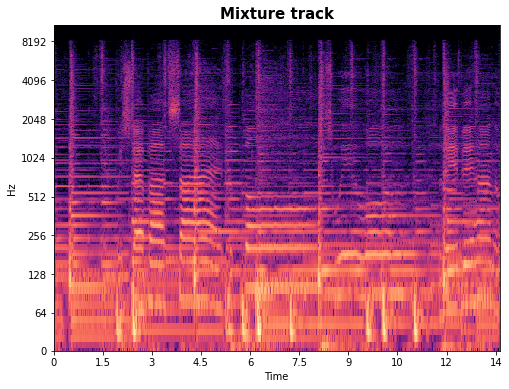

In [ ]:
X = np.abs(librosa.stft(librosa.to_mono(track.audio.T)))
S_vocals = np.abs(librosa.stft(librosa.to_mono(track.targets['vocals'].audio.T)))
S_drums = np.abs(librosa.stft(librosa.to_mono(track.targets['drums'].audio.T)))
S_bass = np.abs(librosa.stft(librosa.to_mono(track.targets['bass'].audio.T)))
S_other = np.abs(librosa.stft(librosa.to_mono(track.targets['other'].audio.T)))
S_accompaniment = np.abs(librosa.stft(librosa.to_mono(track.targets['accompaniment'].audio.T)))


plt.figure(figsize=(8,6))
librosa.display.specshow(librosa.amplitude_to_db(X, ref=np.max), y_axis='log', x_axis='time');
plt.title("Mixture track", fontsize=15, weight='bold');

### **Spectrograms for the individual source stems**

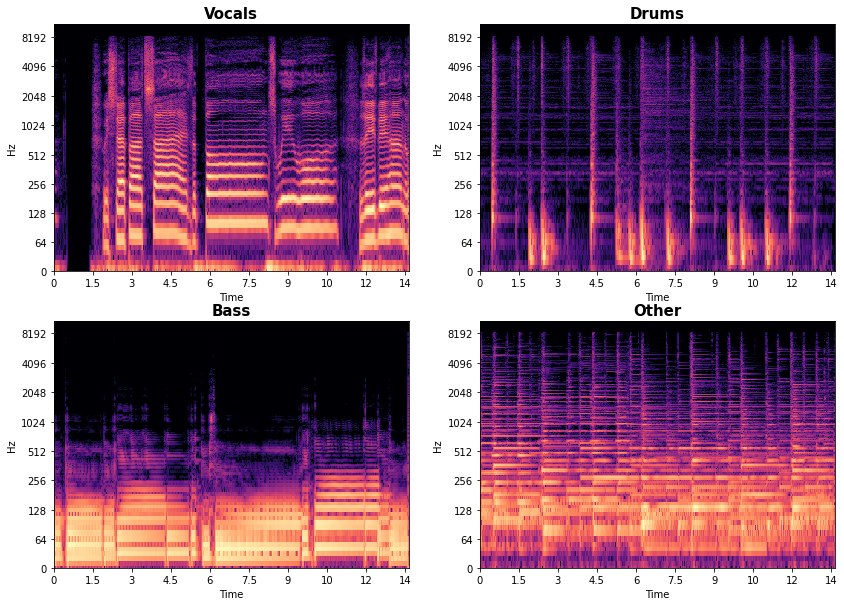

In [ ]:
plt.figure(figsize=(14,10))
plt.subplot(2,2,1)
librosa.display.specshow(librosa.amplitude_to_db(S_vocals, ref=np.max), y_axis='log', x_axis='time');
plt.title("Vocals", fontsize=15, weight='bold');

plt.subplot(2,2,2)
librosa.display.specshow(librosa.amplitude_to_db(S_drums, ref=np.max), y_axis='log', x_axis='time');
plt.title("Drums", fontsize=15, weight='bold');

plt.subplot(2,2,3)
librosa.display.specshow(librosa.amplitude_to_db(S_bass, ref=np.max), y_axis='log', x_axis='time');
plt.title("Bass", fontsize=15, weight='bold');

plt.subplot(2,2,4)
librosa.display.specshow(librosa.amplitude_to_db(S_other, ref=np.max), y_axis='log', x_axis='time');
plt.title("Other", fontsize=15, weight='bold');

# **Separating vocals manually by creating and using a mask**

Here we demonstrate separating vocals by applying a mask to the mixture. This is one of the analytical techniques to separate mixture tracks if the individual source tracks are available. This method is called __oracle filtering__.

The steps to do this are as follows.

1. Compute the ratio mask

$Mask_{vocals}=\frac{S_{vocals}}{S_{vocals}+S_{accompaniment}}$

2. Multiply the mask to the mixture to get the vocals

3. Perform inverse-STFT transform to the separated vocals

In [ ]:
# small epsilon to avoid dividing by zero
eps = np.finfo(np.float).eps

# compute model as the sum of spectrograms
model = eps + np.abs(S_vocals) + np.abs(S_accompaniment)

# compute ratio mask as the ratio between source spectrogram and total
Mask_vocals = np.divide(np.abs(S_vocals), model)

# multiply the mix by the mask
Y_vocals = np.multiply(X, Mask_vocals)

# invert to time domain
vocals_estimate = librosa.istft(Y_vocals)

Audio(vocals_estimate, rate=track.rate)

# **Open-Unmix model**

### __Setup Vocal Separation Scenario__

<img src="https://sigsep.github.io/eusipco2019_tutorial/assets/twosw.gif" width="450">

# **Dataset initialization and Data Loader**

In [ ]:
class SimpleMUSDBDataset(torch.utils.data.Dataset):
    def __init__(
        self,
        subset='train',
        split='train',
        target='vocals',
        seq_duration=None,
    ):
        """MUSDB18 Dataset wrapper
        """
        self.seq_duration = seq_duration
        self.target = target
        self.mus = musdb.DB(
            download=True,
            split=split,
            subsets=subset,
        )

    def __getitem__(self, index):
        track = self.mus[index]
        track.chunk_start = random.uniform(0, track.duration - self.seq_duration)
        track.chunk_duration = self.seq_duration
        x = track.audio.T
        y = track.targets[self.target].audio.T
        return torch.tensor(x, dtype=torch.float32), torch.tensor(y, dtype=torch.float32)


    def __len__(self):
        return len(self.mus)

train_dataset = SimpleMUSDBDataset(seq_duration=5.0)
train_sampler = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)
print(len(train_dataset))        

Done!
80


In [ ]:
%cd open-unmix-pytorch/

/content/open-unmix-pytorch


In [ ]:
import model
import torch.nn as nn

# create a spectrogram layer
stft = model.STFT(n_fft=2048, n_hop=1024)
spec = model.Spectrogram(mono=True)
transform = nn.Sequential(stft, spec)

In [ ]:
# Calculate mean and standard deviation of the dataset
scaler = sklearn.preprocessing.StandardScaler()

for x, y in tqdm_notebook(train_dataset):
    X = transform(x[None])
    scaler.partial_fit(X.squeeze().numpy())

# set inital input scaler values
scale = np.maximum(
    scaler.scale_,
    1e-4*np.max(scaler.scale_)
)
mean = scaler.mean_

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
torch.manual_seed(42)
kwargs = {'num_workers': 1, 'pin_memory': True} if use_cuda else {}

# **Initialize model, optimizer, and criterion (loss)**

In [ ]:
import torch.optim as optim

unmix_v = model.OpenUnmix(
    input_mean=mean,
    input_scale=scale,
    nb_channels=1,
    hidden_size=256,
    n_fft=2048,
    n_hop=1024,
    max_bin=64,
    sample_rate=44100
).to(device)
    
optimizer_v = optim.RMSprop(unmix_v.parameters(), lr=0.001)
criterion = torch.nn.MSELoss()

# **Train a vocal model**

In [ ]:
import utils
losses_v = utils.AverageMeter()
loss_vocals = []
unmix_v.train()

for i in range(50):
    for x, y in train_sampler:
        x, y = x.to(device), y.to(device)
        optimizer_v.zero_grad()
        Y_hat = unmix_v(x)
        Y = unmix_v.transform(y)
        loss = torch.nn.functional.mse_loss(Y_hat, Y)
        loss.backward()
        optimizer_v.step()
        losses_v.update(loss.item(), Y.size(1))
    loss_vocals.append(losses_v.avg)    
    print("Epoch: {}, Loss: {}".format(i, losses_v.avg))

Epoch: 0, Loss: 9.86179323196411
Epoch: 1, Loss: 7.839603424072266
Epoch: 2, Loss: 6.739298033714294
Epoch: 3, Loss: 6.068775755167008
Epoch: 4, Loss: 5.565144753456115
Epoch: 5, Loss: 5.168489638964335
Epoch: 6, Loss: 4.890354013442993
Epoch: 7, Loss: 4.663906198740006
Epoch: 8, Loss: 4.431954924265543
Epoch: 9, Loss: 4.241501196622848
Epoch: 10, Loss: 4.100904083251953
Epoch: 11, Loss: 3.9627936869859695
Epoch: 12, Loss: 3.8400531145242542
Epoch: 13, Loss: 3.7217387820993153
Epoch: 14, Loss: 3.6126319114367167
Epoch: 15, Loss: 3.521233084052801
Epoch: 16, Loss: 3.4329622871735515
Epoch: 17, Loss: 3.3418129934204948
Epoch: 18, Loss: 3.263366559304689
Epoch: 19, Loss: 3.1968859994411467
Epoch: 20, Loss: 3.1256918356532144
Epoch: 21, Loss: 3.059481580690904
Epoch: 22, Loss: 2.998701400342195
Epoch: 23, Loss: 2.9374409715334573
Epoch: 24, Loss: 2.879937517404556
Epoch: 25, Loss: 2.824896270724443
Epoch: 26, Loss: 2.778410728993239
Epoch: 27, Loss: 2.7335546431796893
Epoch: 28, Loss: 2.69

In [ ]:
torch.save(unmix_v.state_dict(), '/content/unmix_v.pt')

In [ ]:
import numpy as np
np.save('/content/loss_vocal', loss_vocals)

### Train __DRUMS__ model

In [ ]:
train_d_dataset = SimpleMUSDBDataset(target = 'drums', seq_duration=5.0)
train_d_sampler = torch.utils.data.DataLoader(train_d_dataset, batch_size=8, shuffle=True)
print(len(train_d_dataset))     

# Calculate mean and standard deviation of the dataset
scaler = sklearn.preprocessing.StandardScaler()

for x, y in train_d_dataset:
    X = transform(x[None])
    scaler.partial_fit(X.squeeze().numpy())

# set inital input scaler values
scale = np.maximum(
    scaler.scale_,
    1e-4*np.max(scaler.scale_)
)
mean = scaler.mean_

80


In [ ]:
unmix_d = model.OpenUnmix(
    input_mean=mean,
    input_scale=scale,
    nb_channels=1,
    hidden_size=256,
    n_fft=2048,
    n_hop=1024,
    max_bin=64,
    sample_rate=44100
).to(device)
    
optimizer_d = optim.RMSprop(unmix_d.parameters(), lr=0.001)

In [ ]:
losses_d = utils.AverageMeter()
unmix_d.train()
loss_drums = []

for i in range(50):
    for x, y in train_d_sampler:
        x, y = x.to(device), y.to(device)
        optimizer_d.zero_grad()
        Y_hat = unmix_d(x)
        Y = unmix_d.transform(y)
        loss = torch.nn.functional.mse_loss(Y_hat, Y)
        loss.backward()
        optimizer_d.step()
        losses_d.update(loss.item(), Y.size(1))
    loss_drums.append(losses_d.avg)
    print("Epoch: {}, Loss: {}".format(i, losses_d.avg))

Epoch: 0, Loss: 8.915864610671997
Epoch: 1, Loss: 6.933729219436645
Epoch: 2, Loss: 5.932899061838786
Epoch: 3, Loss: 5.370740795135498
Epoch: 4, Loss: 4.9473031854629514
Epoch: 5, Loss: 4.595980721712112
Epoch: 6, Loss: 4.322556487151554
Epoch: 7, Loss: 4.090261752903461
Epoch: 8, Loss: 3.888720999823676
Epoch: 9, Loss: 3.7138053190708162
Epoch: 10, Loss: 3.571929517659274
Epoch: 11, Loss: 3.4352802634239197
Epoch: 12, Loss: 3.3156200335575985
Epoch: 13, Loss: 3.2096020221710204
Epoch: 14, Loss: 3.112815637588501
Epoch: 15, Loss: 3.0214995317161084
Epoch: 16, Loss: 2.942622172832489
Epoch: 17, Loss: 2.8660398218366834
Epoch: 18, Loss: 2.7958360044579758
Epoch: 19, Loss: 2.7285666573047638
Epoch: 20, Loss: 2.663028525738489
Epoch: 21, Loss: 2.6011375833641397
Epoch: 22, Loss: 2.545770022402639
Epoch: 23, Loss: 2.4917138467232385
Epoch: 24, Loss: 2.4395531187057493
Epoch: 25, Loss: 2.391028251327001
Epoch: 26, Loss: 2.3460935190871908
Epoch: 27, Loss: 2.303147848163332
Epoch: 28, Loss: 

In [ ]:
torch.save(unmix_d.state_dict(), '/content/unmix_d.pt')
np.save('/content/loss_drums', loss_drums)

### Train __Bass__ model

In [ ]:
train_b_dataset = SimpleMUSDBDataset(target = 'bass', seq_duration=5.0)
train_b_sampler = torch.utils.data.DataLoader(train_b_dataset, batch_size=8, shuffle=True)
print(len(train_b_dataset))     

# Calculate mean and standard deviation of the dataset
scaler = sklearn.preprocessing.StandardScaler()

for x, y in train_b_dataset:
    X = transform(x[None])
    scaler.partial_fit(X.squeeze().numpy())

# set inital input scaler values
scale = np.maximum(
    scaler.scale_,
    1e-4*np.max(scaler.scale_)
)
mean = scaler.mean_

80


In [ ]:
unmix_b = model.OpenUnmix(
    input_mean=mean,
    input_scale=scale,
    nb_channels=1,
    hidden_size=256,
    n_fft=2048,
    n_hop=1024,
    max_bin=64,
    sample_rate=44100
).to(device)
    
optimizer_b = optim.RMSprop(unmix_b.parameters(), lr=0.001)

In [ ]:
losses_b = utils.AverageMeter()
unmix_b.train()
loss_bass = []

for i in range(50):
    for x, y in train_b_sampler:
        x, y = x.to(device), y.to(device)
        optimizer_b.zero_grad()
        Y_hat = unmix_b(x)
        Y = unmix_b.transform(y)
        loss = torch.nn.functional.mse_loss(Y_hat, Y)
        loss.backward()
        optimizer_b.step()
        losses_b.update(loss.item(), Y.size(1))
    loss_bass.append(losses_b.avg)
    print("Epoch: {}, Loss: {}".format(i, losses_b.avg))

Epoch: 0, Loss: 10.309163475036621
Epoch: 1, Loss: 7.744343054294586
Epoch: 2, Loss: 6.625192459424337
Epoch: 3, Loss: 5.927161258459091
Epoch: 4, Loss: 5.41549174785614
Epoch: 5, Loss: 5.016646691163381
Epoch: 6, Loss: 4.7475825820650375
Epoch: 7, Loss: 4.486819872260094
Epoch: 8, Loss: 4.285696286625332
Epoch: 9, Loss: 4.1189173579216005
Epoch: 10, Loss: 3.9469302535057067
Epoch: 11, Loss: 3.8149286448955535
Epoch: 12, Loss: 3.683749140225924
Epoch: 13, Loss: 3.5680154749325346
Epoch: 14, Loss: 3.4492798614501954
Epoch: 15, Loss: 3.350522167980671
Epoch: 16, Loss: 3.2598859744913438
Epoch: 17, Loss: 3.1737624512778386
Epoch: 18, Loss: 3.0889236789000662
Epoch: 19, Loss: 3.010397133529186
Epoch: 20, Loss: 2.935065156789053
Epoch: 21, Loss: 2.8625405065037985
Epoch: 22, Loss: 2.7947483327077784
Epoch: 23, Loss: 2.7327589253584543
Epoch: 24, Loss: 2.6734603991508483
Epoch: 25, Loss: 2.6193465611109366
Epoch: 26, Loss: 2.5708285876998196
Epoch: 27, Loss: 2.517924444590296
Epoch: 28, Loss

In [ ]:
torch.save(unmix_b.state_dict(), '/content/unmix_b.pt')
np.save('/content/loss_bass', loss_bass)

### Train __Others__ model

In [ ]:
train_o_dataset = SimpleMUSDBDataset(target = 'other', seq_duration=5.0)
train_o_sampler = torch.utils.data.DataLoader(train_o_dataset, batch_size=8, shuffle=True)
print(len(train_o_dataset))     

# Calculate mean and standard deviation of the dataset
scaler = sklearn.preprocessing.StandardScaler()

for x, y in train_o_dataset:
    X = transform(x[None])
    scaler.partial_fit(X.squeeze().numpy())

# set inital input scaler values
scale = np.maximum(
    scaler.scale_,
    1e-4*np.max(scaler.scale_)
)
mean = scaler.mean_

80


In [ ]:
unmix_o = model.OpenUnmix(
    input_mean=mean,
    input_scale=scale,
    nb_channels=1,
    hidden_size=256,
    n_fft=2048,
    n_hop=1024,
    max_bin=64,
    sample_rate=44100
).to(device)
    
optimizer_o = optim.RMSprop(unmix_o.parameters(), lr=0.001)

In [ ]:
losses_o = utils.AverageMeter()
unmix_o.train()
loss_other = []

for i in range(50):
    for x, y in train_o_sampler:
        x, y = x.to(device), y.to(device)
        optimizer_o.zero_grad()
        Y_hat = unmix_o(x)
        Y = unmix_o.transform(y)
        loss = torch.nn.functional.mse_loss(Y_hat, Y)
        loss.backward()
        optimizer_o.step()
        losses_o.update(loss.item(), Y.size(1))
    loss_other.append(losses_o.avg)
    print("Epoch: {}, Loss: {}".format(i, losses_o.avg))

Epoch: 0, Loss: 8.51604642868042
Epoch: 1, Loss: 6.557452845573425
Epoch: 2, Loss: 5.7078708489735925
Epoch: 3, Loss: 5.167017763853073
Epoch: 4, Loss: 4.773594460487366
Epoch: 5, Loss: 4.451219407717387
Epoch: 6, Loss: 4.215214487484523
Epoch: 7, Loss: 4.027956473827362
Epoch: 8, Loss: 3.8492056290308634
Epoch: 9, Loss: 3.6937541508674623
Epoch: 10, Loss: 3.565434980392456
Epoch: 11, Loss: 3.456577731172244
Epoch: 12, Loss: 3.35307154747156
Epoch: 13, Loss: 3.2518425362450736
Epoch: 14, Loss: 3.1634916655222574
Epoch: 15, Loss: 3.0794842720031737
Epoch: 16, Loss: 3.003451880987953
Epoch: 17, Loss: 2.9393153693940905
Epoch: 18, Loss: 2.883851100896534
Epoch: 19, Loss: 2.823709764480591
Epoch: 20, Loss: 2.767134561992827
Epoch: 21, Loss: 2.7141008550470525
Epoch: 22, Loss: 2.66314136515493
Epoch: 23, Loss: 2.6152381867170336
Epoch: 24, Loss: 2.569366096973419
Epoch: 25, Loss: 2.5274496601178096
Epoch: 26, Loss: 2.4850252133828623
Epoch: 27, Loss: 2.4433217108249665
Epoch: 28, Loss: 2.40

In [ ]:
torch.save(unmix_o.state_dict(), '/content/unmix_o.pt')
np.save('/content/loss_other', loss_other)

In [ ]:
unmix_v

OpenUnmix(
  (stft): STFT()
  (spec): Spectrogram()
  (transform): Sequential(
    (0): STFT()
    (1): Spectrogram()
  )
  (fc1): Linear(in_features=64, out_features=256, bias=False)
  (bn1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (lstm): LSTM(256, 128, num_layers=3, dropout=0.4, bidirectional=True)
  (fc2): Linear(in_features=512, out_features=256, bias=False)
  (bn2): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc3): Linear(in_features=256, out_features=1025, bias=False)
  (bn3): BatchNorm1d(1025, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)

# **Calculate cumulative loss**

In [ ]:
cumulative_loss = (np.array(loss_vocals) + \
                  np.array(loss_drums) + \
                  np.array(loss_bass) + \
                  np.array(loss_other) ) /4

# **Plot the Loss for all the four models versus number of epochs**

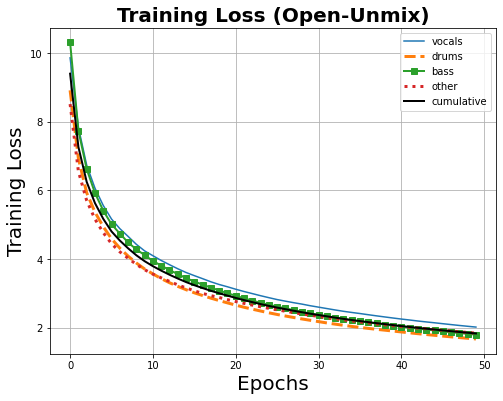

In [ ]:
plt.figure(figsize=(8,6))
plt.plot(loss_vocals, label='vocals')
plt.plot(loss_drums, label='drums', linestyle='--', linewidth=3)
plt.plot(loss_bass, label='bass', linestyle=None, marker='s' , linewidth=2)
plt.plot(loss_other, label='other', linestyle='dotted', linewidth=3)
plt.plot(cumulative_loss, label='cumulative', color = 'black', linewidth = 2)
plt.legend()
plt.xlabel("Epochs", fontsize=20)
plt.ylabel("Training Loss", fontsize=20)
plt.title("Training Loss (Open-Unmix)", fontsize=20, weight="bold");
plt.grid(True)

# **Separate __test__ mixture tracks**

### **Download test set**

In [ ]:
import musdb
mus = musdb.DB(download=True, subsets='test')
track = mus[1]

In [ ]:
#Inverse STFT transformation

def istft(X, rate=44100, n_fft=2048, n_hopsize=1024):
    t, audio = scipy.signal.istft(
        X / (n_fft / 2),
        rate,
        nperseg=n_fft,
        noverlap=n_fft - n_hopsize,
        boundary=True
    )
    return audio

### **Vocals - separation**

In [ ]:
unmix_v.stft.center = True
unmix_v.eval()

audio_torch = torch.tensor(track.audio.T[None, ...]).float().to(device)

Vj = unmix_v(audio_torch).cpu().detach().numpy()

# compute STFT
X = unmix_v.stft(audio_torch).detach().cpu().numpy()
# convert to complex numpy
X = X[..., 0] + X[..., 1]*1j
X = X[0].transpose(2, 1, 0)

V = Vj[:, 0, ...].transpose(0, 2, 1)[..., None]
V = norbert.residual_model(V, X)
Y = norbert.wiener(V, X.astype(np.complex128), iterations=2)
estimates = {}
for j, name in enumerate(['vocals', 'accompaniment']):
    audio_hat = istft(
        Y[..., j].T,
        n_fft=unmix_v.stft.n_fft,
        n_hopsize=unmix_v.stft.n_hop
    )
    estimates[name] = audio_hat.T

In [ ]:
 for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=track.rate))

vocals


accompaniment


In [ ]:
  # Evaluate using museval
  scores = museval.eval_mus_track(
      track, estimates, output_dir="/content/vocals_acc.json"
  )

  # print nicely formatted and aggregated scores
  print(scores)

vocals          ==> SDR:   4.170  SIR:   6.341  ISR:  10.680  SAR:   5.835  
accompaniment   ==> SDR:   5.334  SIR:   8.936  ISR:   9.943  SAR:   6.896  



### **Drums -  separation**

In [ ]:
unmix_d.stft.center = True
unmix_d.eval()

audio_torch = torch.tensor(track.audio.T[None, ...]).float().to(device)

Vj = unmix_d(audio_torch).cpu().detach().numpy()

# compute STFT
X = unmix_d.stft(audio_torch).detach().cpu().numpy()
# convert to complex numpy
X = X[..., 0] + X[..., 1]*1j
X = X[0].transpose(2, 1, 0)

V = Vj[:, 0, ...].transpose(0, 2, 1)[..., None]
V = norbert.residual_model(V, X)
Y = norbert.wiener(V, X.astype(np.complex128), iterations=2)
estimates = {}
for j, name in enumerate(['drums', 'accompaniment']):
    audio_hat = istft(
        Y[..., j].T,
        n_fft=unmix_d.stft.n_fft,
        n_hopsize=unmix_d.stft.n_hop
    )
    estimates[name] = audio_hat.T

In [ ]:
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=track.rate))

drums


accompaniment


In [ ]:
  # Evaluate using museval
  scores = museval.eval_mus_track(
      track, estimates, output_dir="/content/drums_acc.json"
  )

  # print nicely formatted and aggregated scores
  print(scores)

drums           ==> SDR:  -1.122  SIR:   2.601  ISR:  10.148  SAR:   0.358  
accompaniment   ==> SDR:   0.010  SIR:  10.378  ISR:   8.062  SAR:  -2.052  



### **Bass - separation**

In [ ]:
unmix_b.stft.center = True
unmix_b.eval()

audio_torch = torch.tensor(track.audio.T[None, ...]).float().to(device)

Vj = unmix_b(audio_torch).cpu().detach().numpy()

# compute STFT
X = unmix_b.stft(audio_torch).detach().cpu().numpy()
# convert to complex numpy
X = X[..., 0] + X[..., 1]*1j
X = X[0].transpose(2, 1, 0)

V = Vj[:, 0, ...].transpose(0, 2, 1)[..., None]
V = norbert.residual_model(V, X)
Y = norbert.wiener(V, X.astype(np.complex128), iterations=2)
estimates = {}
for j, name in enumerate(['bass', 'accompaniment']):
    audio_hat = istft(
        Y[..., j].T,
        n_fft=unmix_b.stft.n_fft,
        n_hopsize=unmix_b.stft.n_hop
    )
    estimates[name] = audio_hat.T

In [ ]:
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=track.rate))

bass


accompaniment


In [ ]:
  # Evaluate using museval
  scores = museval.eval_mus_track(
      track, estimates, output_dir="/content/bass_acc.json"
  )

  # print nicely formatted and aggregated scores
  print(scores)

bass            ==> SDR:   2.164  SIR:   7.517  ISR:   7.349  SAR:   3.385  
accompaniment   ==> SDR:  -0.416  SIR:   7.122  ISR:   4.961  SAR:  -2.300  



### **Other - separation**

In [ ]:
unmix_o.stft.center = True
unmix_o.eval()

audio_torch = torch.tensor(track.audio.T[None, ...]).float().to(device)

Vj = unmix_o(audio_torch).cpu().detach().numpy()

# compute STFT
X = unmix_o.stft(audio_torch).detach().cpu().numpy()
# convert to complex numpy
X = X[..., 0] + X[..., 1]*1j
X = X[0].transpose(2, 1, 0)

V = Vj[:, 0, ...].transpose(0, 2, 1)[..., None]
V = norbert.residual_model(V, X)
Y = norbert.wiener(V, X.astype(np.complex128), iterations=2)
estimates = {}
for j, name in enumerate(['other', 'accompaniment']):
    audio_hat = istft(
        Y[..., j].T,
        n_fft=unmix_o.stft.n_fft,
        n_hopsize=unmix_o.stft.n_hop
    )
    estimates[name] = audio_hat.T

In [ ]:
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=track.rate))

other


accompaniment


In [ ]:
  # Evaluate using museval
  scores = museval.eval_mus_track(
      track, estimates, output_dir="/content/other_acc.json"
  )

  # print nicely formatted and aggregated scores
  print(scores)

other           ==> SDR:  -2.103  SIR:   3.733  ISR:   8.196  SAR:  -1.228  
accompaniment   ==> SDR:   1.446  SIR:  12.928  ISR:   5.135  SAR:  -0.557  



# **Use Transfer learning for separation**

In [ ]:
import test
estimates = test.separate(
    audio=track.audio, 
    targets=['vocals', 'drums', 'bass', 'other'], 
    residual_model=False,
    niter=1,
    device=device
)
for target, estimate in estimates.items():
    print(target)
    display(Audio(estimate.T, rate=track.rate))

  0%|          | 0/4 [00:00<?, ?it/s]

 25%|██▌       | 1/4 [00:09<00:29,  9.93s/it]

 50%|█████     | 2/4 [00:18<00:18,  9.47s/it]

 75%|███████▌  | 3/4 [00:27<00:09,  9.45s/it]

100%|██████████| 4/4 [00:36<00:00,  9.19s/it]

vocals


drums


bass


other


In [ ]:
  # Evaluate using museval
  scores = museval.eval_mus_track(
      track, estimates, output_dir="/content/pre_trained.json"
  )

  # print nicely formatted and aggregated scores
  print(scores)

vocals          ==> SDR:   7.127  SIR:  12.742  ISR:  11.085  SAR:   9.335  
drums           ==> SDR:   4.022  SIR:   3.751  ISR:   8.305  SAR:   3.363  
bass            ==> SDR:   6.187  SIR:  12.988  ISR:   7.644  SAR:   8.331  
other           ==> SDR:   2.629  SIR:   3.264  ISR:   7.300  SAR:   4.901  

